In [1]:
using Distributions
using HypothesisTests

function student_t_test(X, Y; Δμ = 0.0)
    m, X̄, SX2 = length(X), mean(X), var(X)
    n, Ȳ, SY2 = length(Y), mean(Y), var(Y)
    S2 = ((m-1)*SX2 + (n-1)*SY2) / (m+n-2)
    sehat2 = S2 * (1/m + 1/n)
    tvalue = (X̄ - Ȳ - Δμ) / √sehat2
    df = m + n - 2
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; pvalue, tvalue, sehat2, df)
end

pvalue_student_t_test(X, Y; Δμ = 0.0) = student_t_test(X, Y; Δμ).pvalue

function welch_t_test(X, Y; Δμ = 0.0)
    m, X̄, SX2 = length(X), mean(X), var(X)
    n, Ȳ, SY2 = length(Y), mean(Y), var(Y)
    sehat2 = SX2/m + SY2/n
    tvalue = (X̄ - Ȳ - Δμ) / √sehat2
    df = sehat2^2 / ((SX2/m)^2/(m-1) + (SY2/n)^2/(n-1))
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; pvalue, tvalue, sehat2, df)
end

pvalue_welch_t_test(X, Y; Δμ = 0.0) =welch_t_test(X, Y; Δμ).pvalue

function confint_welch_t_test(X, Y; α = 0.05)
    m, X̄, SX2 = length(X), mean(X), var(X)
    n, Ȳ, SY2 = length(Y), mean(Y), var(Y)
    sehat2 = SX2/m + SY2/n
    df = sehat2^2 / ((SX2/m)^2/(m-1) + (SY2/n)^2/(n-1))
    c = cquantile(TDist(df), α/2)
    ci = [X̄ - Ȳ - c*√sehat2, X̄ - Ȳ + c*√sehat2]
    ci
end

function pvalue_mann_whitney_utest(X, Y)
    o = MannWhitneyUTest(X, Y)
    pvalue(o)
end

function brunner_munzel_test(X, Y; p=1/2)
    m, n = length(X), length(Y)
    phat = mean((x < y) + (x == y)/2 for x in X, y in Y)
    Hbarx = n*(1 - phat)
    Hbary = m*phat
    sx2 = 1/n^2 * 1/(m-1) * sum(x -> (sum((y < x) + (y == x)/2 for y in Y) - Hbarx)^2, X)
    sy2 = 1/m^2 * 1/(n-1) * sum(y -> (sum((x < y) + (x == y)/2 for x in X) - Hbary)^2, Y)
    sehat = √(sx2/m + sy2/n)
    tvalue = (phat - p)/sehat
    df = (sx2/m + sy2/n)^2 / ((sx2/m)^2/(m-1) + (sy2/n)^2/(n-1))
    pvalue = 2ccdf(TDist(df), abs(tvalue))
    (; phat, sehat, tvalue, df, pvalue, p)
end

pvalue_brunner_munzel_test(X, Y; p=1/2) = brunner_munzel_test(X, Y; p).pvalue

pvalue_brunner_munzel_test (generic function with 1 method)

https://x.com/__fusion/status/1736851891068498229

* 治療薬: 6.7, 6.8, 9.0, 8.8, 6.5, 7.7, 8.1, 7.5, 6.5, 9.5, 6.6, 5.9
* 対照薬: 9.8, 9.6, 8.3, 8.9, 8.1, 7.9, 8.7, 8.3, 6.7, 8.8, 6.9, 10.0, 8.0, 7.8

In [2]:
Y = [6.7, 6.8, 9.0, 8.8, 6.5, 7.7, 8.1, 7.5, 6.5, 9.5, 6.6, 5.9]
X = [9.8, 9.6, 8.3, 8.9, 8.1, 7.9, 8.7, 8.3, 6.7, 8.8, 6.9, 10.0, 8.0, 7.8]

@show pvalue_student_t_test(X, Y)
@show pvalue_welch_t_test(X, Y)
@show pvalue_mann_whitney_utest(X, Y)
@show pvalue_brunner_munzel_test(X, Y)
@show confint_welch_t_test(X, Y);

pvalue_student_t_test(X, Y) = 0.03328902422723399
pvalue_welch_t_test(X, Y) = 0.03656865718074425
pvalue_mann_whitney_utest(X, Y) = 0.03480523086767612
pvalue_brunner_munzel_test(X, Y) = 0.03012104638060681
confint_welch_t_test(X, Y) = [0.06486919057469998, 1.8303689046633975]


In [3]:
using Distributions
using Random

# Jeffreys事前分布などのimproper事前分布を定義するために以下が使われる.

"""
    PowerPos(p::Real)

The *positive power distribution* with real-valued parameter `p` is the improper distribution
of real numbers that has the improper probability density function

```math
f(x) = \\begin{cases}
0 & \\text{if } x \\leq 0, \\\\
x^p & \\text{otherwise}.
\\end{cases}
```
"""
struct PowerPos{T<:Real} <: ContinuousUnivariateDistribution
    p::T
end
PowerPos(p::Integer) = PowerPos(float(p))

Base.minimum(d::PowerPos{T}) where T = zero(T)
Base.maximum(d::PowerPos{T}) where T = T(Inf)

Base.rand(rng::Random.AbstractRNG, d::PowerPos) = rand(rng) + 0.5
function Distributions.logpdf(d::PowerPos, x::Real)
    T = float(eltype(x))
    return x ≤ 0 ? T(-Inf) : d.p*log(x)
end

Distributions.pdf(d::PowerPos, x::Real) = exp(logpdf(d, x))

# For vec support
function Distributions.loglikelihood(d::PowerPos, x::AbstractVector{<:Real})
    T = float(eltype(x))
    return any(xi ≤ 0 for xi in x) ? T(-Inf) : d.p*log(prod(x))
end

@doc PowerPos

```
PowerPos(p::Real)
```

The *positive power distribution* with real-valued parameter `p` is the improper distribution of real numbers that has the improper probability density function

$$
f(x) = \begin{cases}
0 & \text{if } x \leq 0, \\
x^p & \text{otherwise}.
\end{cases}
$$


In [4]:
ENV["COLUMNS"] = 200
using Turing
using LinearAlgebra
using StatsPlots
default(fmt=:png)

In [5]:
@model function model_FlatPos(X1, X0)
    sigma0 ~ FlatPos(0)
    sigma1 ~ FlatPos(0)
    mu0 ~ Flat()
    deltamu ~ Flat()
    mu1 = mu0 + deltamu
    X0 ~ MvNormal(fill(mu0, length(X0)), sigma0^2*I)
    X1 ~ MvNormal(fill(mu1, length(X1)), sigma1^2*I)
end

model_FlatPos (generic function with 2 methods)

In [6]:
chn_FlatPos = sample(model_FlatPos(X, Y), NUTS(), MCMCThreads(), 10^5, 10);

┌ Info: Found initial step size
└   ϵ = 0.2
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.05
┌ Info: Found initial step size
└   ϵ = 0.4
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.4
┌ Info: Found initial step size
└   ϵ = 0.00625


In [7]:
chn_FlatPos

Chains MCMC chain (100000×16×10 Array{Float64, 3}):

Iterations        = 1001:1:101000
Number of chains  = 10
Samples per chain = 100000
Wall duration     = 82.66 seconds
Compute duration  = 778.93 seconds
parameters        = sigma0, sigma1, mu0, deltamu
internals         = lp, n_steps, is_accept, acceptance_rate, log_density, hamiltonian_energy, hamiltonian_energy_error, max_hamiltonian_energy_error, tree_depth, numerical_error, step_size, nom_step_size

Summary Statistics
  parameters      mean       std      mcse      ess_bulk      ess_tail      rhat   ess_per_sec 
      Symbol   Float64   Float64   Float64       Float64       Float64   Float64       Float64 

      sigma0    1.3191    0.3349    0.0004   699817.6596   535751.5335    1.0000      898.4392
      sigma1    1.0886    0.2461    0.0003   735155.5193   576659.7951    1.0000      943.8066
         mu0    7.4659    0.3936    0.0006   514926.0988   509147.2352    1.0000      661.0719
     deltamu    0.9486    0.4940    0.0007 

In [8]:
@show pvalue_welch_t_test(X, Y)
@show confint_welch_t_test(X, Y);

pvalue_welch_t_test(X, Y) = 0.03656865718074425
confint_welch_t_test(X, Y) = [0.06486919057469998, 1.8303689046633975]


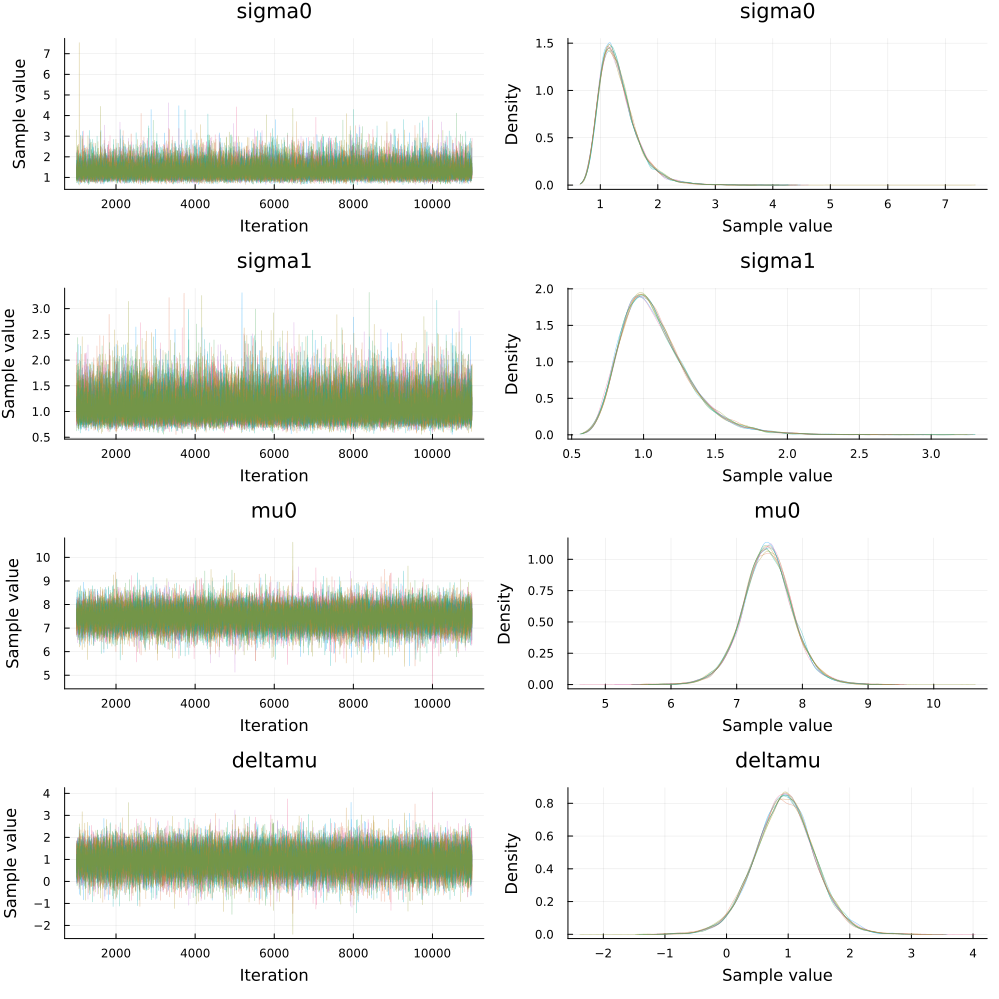

In [9]:
plot(chn_FlatPos[1:min(end, 10000)]; lw=0.5, alpha=0.5)

In [10]:
@model function model_PowerPos(X1, X0)
    sigma0 ~ PowerPos(-1)
    sigma1 ~ PowerPos(-1)
    mu0 ~ Flat()
    deltamu ~ Flat()
    mu1 = mu0 + deltamu
    X0 ~ MvNormal(fill(mu0, length(X0)), sigma0^2*I)
    X1 ~ MvNormal(fill(mu1, length(X1)), sigma1^2*I)
end

model_PowerPos (generic function with 2 methods)

In [11]:
chn_PowerPos = sample(model_PowerPos(X, Y), NUTS(), MCMCThreads(), 10^5, 10);

┌ Info: Found initial step size
└   ϵ = 0.00625
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.05
┌ Info: Found initial step size
└   ϵ = 0.0125
Sampling (10 threads): 100%|████████████████████████████| Time: 0:00:02


In [12]:
chn_PowerPos

Chains MCMC chain (100000×16×10 Array{Float64, 3}):

Iterations        = 1001:1:101000
Number of chains  = 10
Samples per chain = 100000
Wall duration     = 67.35 seconds
Compute duration  = 647.05 seconds
parameters        = sigma0, sigma1, mu0, deltamu
internals         = lp, n_steps, is_accept, acceptance_rate, log_density, hamiltonian_energy, hamiltonian_energy_error, max_hamiltonian_energy_error, tree_depth, numerical_error, step_size, nom_step_size

Summary Statistics
  parameters      mean       std      mcse      ess_bulk      ess_tail      rhat   ess_per_sec 
      Symbol   Float64   Float64   Float64       Float64       Float64   Float64       Float64 

      sigma0    1.2480    0.2980    0.0004   690262.3569   553317.9722    1.0000     1066.7886
      sigma1    1.0412    0.2249    0.0003   714572.2886   556252.4038    1.0000     1104.3592
         mu0    7.4660    0.3704    0.0005   517952.0813   516056.0712    1.0000      800.4860
     deltamu    0.9484    0.4669    0.0006 

In [13]:
@show pvalue_welch_t_test(X, Y)
@show confint_welch_t_test(X, Y);

pvalue_welch_t_test(X, Y) = 0.03656865718074425
confint_welch_t_test(X, Y) = [0.06486919057469998, 1.8303689046633975]


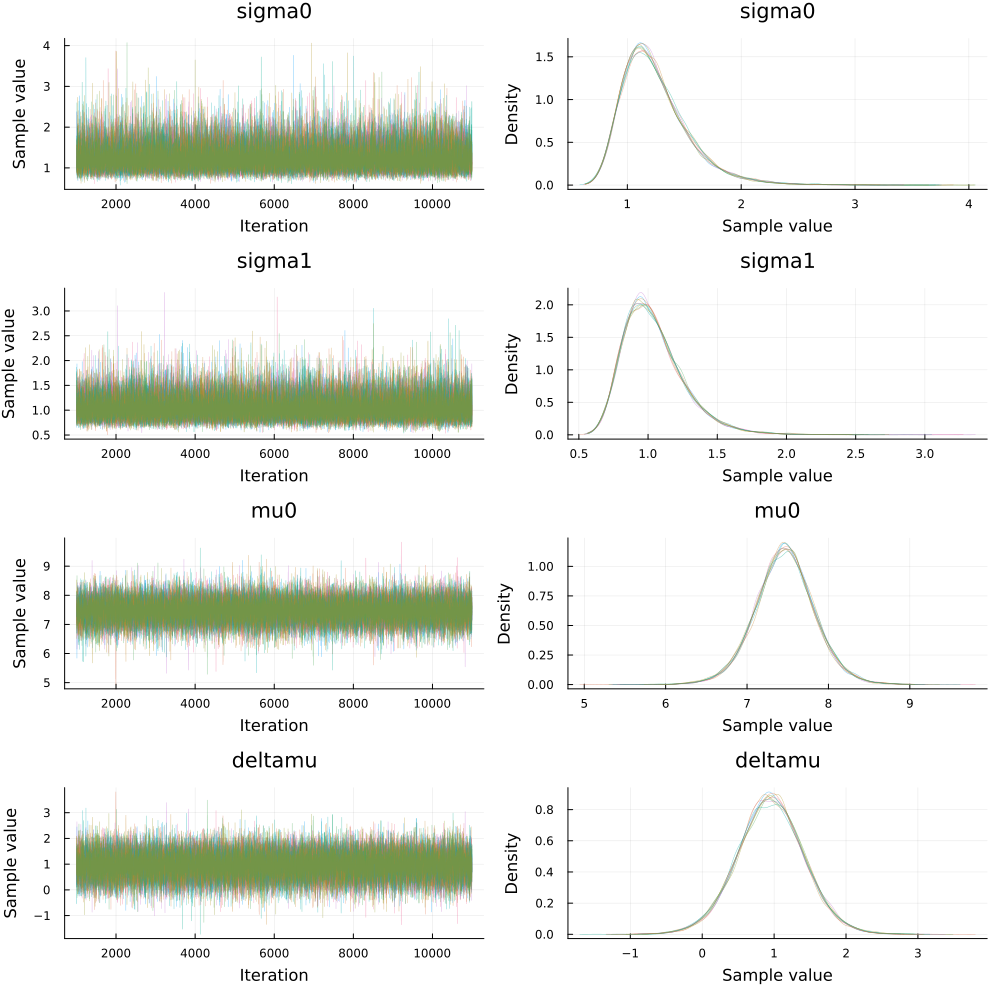

In [14]:
plot(chn_PowerPos[1:min(end, 10000)]; lw=0.5, alpha=0.5)

In [15]:
@model function model_Flat_logsigma(X1, X0)
    logsigma0 ~ Flat()
    logsigma1 ~ Flat()
    mu0 ~ Flat()
    deltamu ~ Flat()
    mu1 = mu0 + deltamu
    X0 ~ MvNormal(fill(mu0, length(X0)), exp(2logsigma0)*I)
    X1 ~ MvNormal(fill(mu1, length(X1)), exp(2logsigma1)*I)
end

model_Flat_logsigma (generic function with 2 methods)

In [16]:
chn_Flat_logsigma = sample(model_Flat_logsigma(X, Y), NUTS(), MCMCThreads(), 10^5, 10);

┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.05
┌ Info: Found initial step size
└   ϵ = 0.00625
┌ Info: Found initial step size
└   ϵ = 0.05
┌ Info: Found initial step size
└   ϵ = 0.025
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.0125
┌ Info: Found initial step size
└   ϵ = 0.0125
Sampling (10 threads): 100%|████████████████████████████| Time: 0:00:03


In [17]:
chn_Flat_logsigma

Chains MCMC chain (100000×16×10 Array{Float64, 3}):

Iterations        = 1001:1:101000
Number of chains  = 10
Samples per chain = 100000
Wall duration     = 80.42 seconds
Compute duration  = 742.91 seconds
parameters        = logsigma0, logsigma1, mu0, deltamu
internals         = lp, n_steps, is_accept, acceptance_rate, log_density, hamiltonian_energy, hamiltonian_energy_error, max_hamiltonian_energy_error, tree_depth, numerical_error, step_size, nom_step_size

Summary Statistics
  parameters      mean       std      mcse      ess_bulk      ess_tail      rhat   ess_per_sec 
      Symbol   Float64   Float64   Float64       Float64       Float64   Float64       Float64 

   logsigma0    0.1961    0.2233    0.0003   714007.0393   550725.0389    1.0000      961.0898
   logsigma1    0.0191    0.2039    0.0002   745646.9591   596577.6199    1.0000     1003.6787
         mu0    7.4670    0.3699    0.0005   538131.5983   538311.1303    1.0000      724.3525
     deltamu    0.9479    0.4666    0

In [18]:
@show pvalue_welch_t_test(X, Y)
@show confint_welch_t_test(X, Y);

pvalue_welch_t_test(X, Y) = 0.03656865718074425
confint_welch_t_test(X, Y) = [0.06486919057469998, 1.8303689046633975]


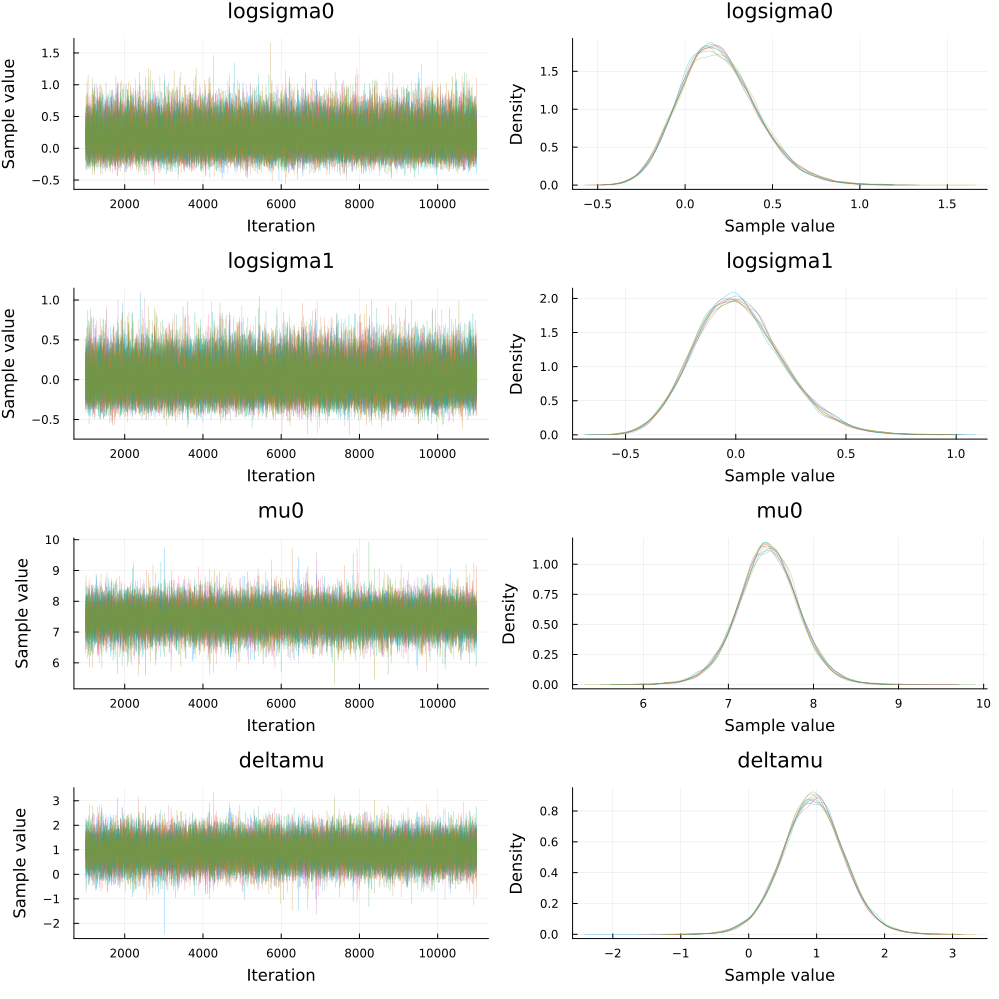

In [19]:
plot(chn_Flat_logsigma[1:min(end, 10000)]; lw=0.5, alpha=0.5)